# Exploratory Data Analysis

In [39]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from tqdm.notebook import tqdm
import os

base_dir = "/Users/zac/Codes/Music_Project/GIT_HUB/Musis_Recommendation_Engine"

# Load the dataset
file_path = 'exploration/Data_collection/final_filtered_mood_list.csv'
df = pd.read_csv(os.path.join(base_dir, file_path))

try:
    df.drop(columns="Unnamed: 0", inplace=True)
except Exception as e:
    print("error occured - ",e)

error occured -  "['Unnamed: 0'] not found in axis"


In [6]:
# import os
# os.path.join(base_dir, file_path)

'/exploration/Data_collection/final_training.csv'

## Basic detail about data

In [40]:

# Display the first few rows of the dataset
print("First few rows of the dataset:")
display(df.head())

# Display basic information about the dataset
print("\nBasic information about the dataset:")
print(df.info())

# Summary statistics of the dataset
print("\nSummary statistics of the dataset:")
print(df.describe())

# Check for missing values
print("\nMissing values in the dataset:")
print(df.isnull().sum())

First few rows of the dataset:


,artist_name,track_name,duration_ms,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,mood
0,Mariah Carey,Loverboy,229173,2001,42,0.721,0.790,1,-4.125,1,0.1240,0.18300,0.0000,0.100,0.821,103.141,SCARED
1,Eminem,Without Me,290320,2002,87,0.908,0.669,7,-2.827,1,0.0738,0.00286,0.0000,0.237,0.662,112.238,SCARED
2,Coldplay,Clocks,307879,2002,79,0.577,0.749,5,-7.215,0,0.0279,0.59900,0.0115,0.183,0.255,130.970,SAD
3,Coldplay,Clocks,307879,2002,79,0.577,0.749,5,-7.215,0,0.0279,0.59900,0.0115,0.183,0.255,130.970,SAD
4,Linkin Park,Numb,185586,2003,81,0.496,0.863,9,-4.153,1,0.0381,0.00460,0.0000,0.639,0.243,110.018,SAD



Basic information about the dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1192 entries, 0 to 1191
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artist_name       1192 non-null   object 
 1   track_name        1192 non-null   object 
 2   duration_ms       1192 non-null   int64  
 3   year              1192 non-null   int64  
 4   popularity        1192 non-null   int64  
 5   danceability      1192 non-null   float64
 6   energy            1192 non-null   float64
 7   key               1192 non-null   int64  
 8   loudness          1192 non-null   float64
 9   mode              1192 non-null   int64  
 10  speechiness       1192 non-null   float64
 11  acousticness      1192 non-null   float64
 12  instrumentalness  1192 non-null   float64
 13  liveness          1192 non-null   float64
 14  valence           1192 non-null   float64
 15  tempo             1192 non-null   float64
 16  mood

## Distribution of moods

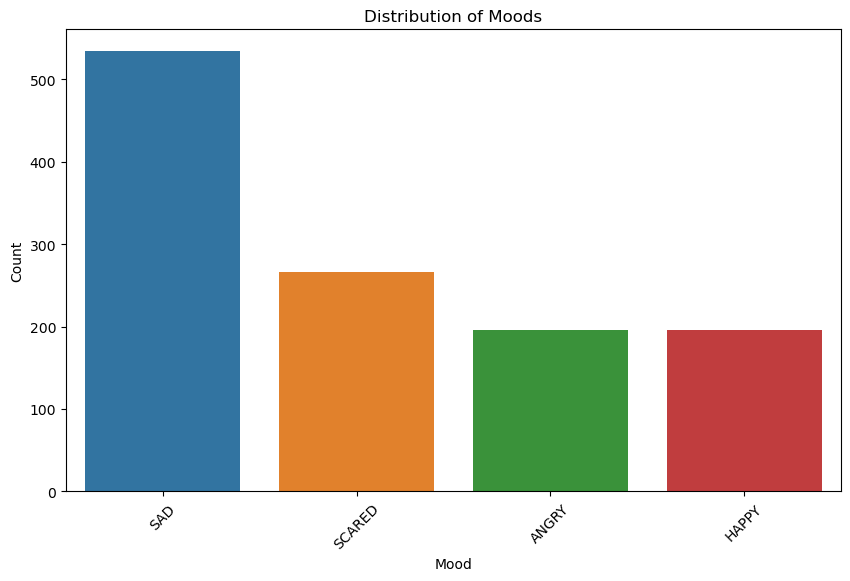

In [41]:

# Distribution of moods
plt.figure(figsize=(10, 6))
sns.countplot(data=df, x='mood', order=df['mood'].value_counts().index)
plt.title('Distribution of Moods')
plt.xlabel('Mood')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()


## Correlation

Non-numeric columns:  []


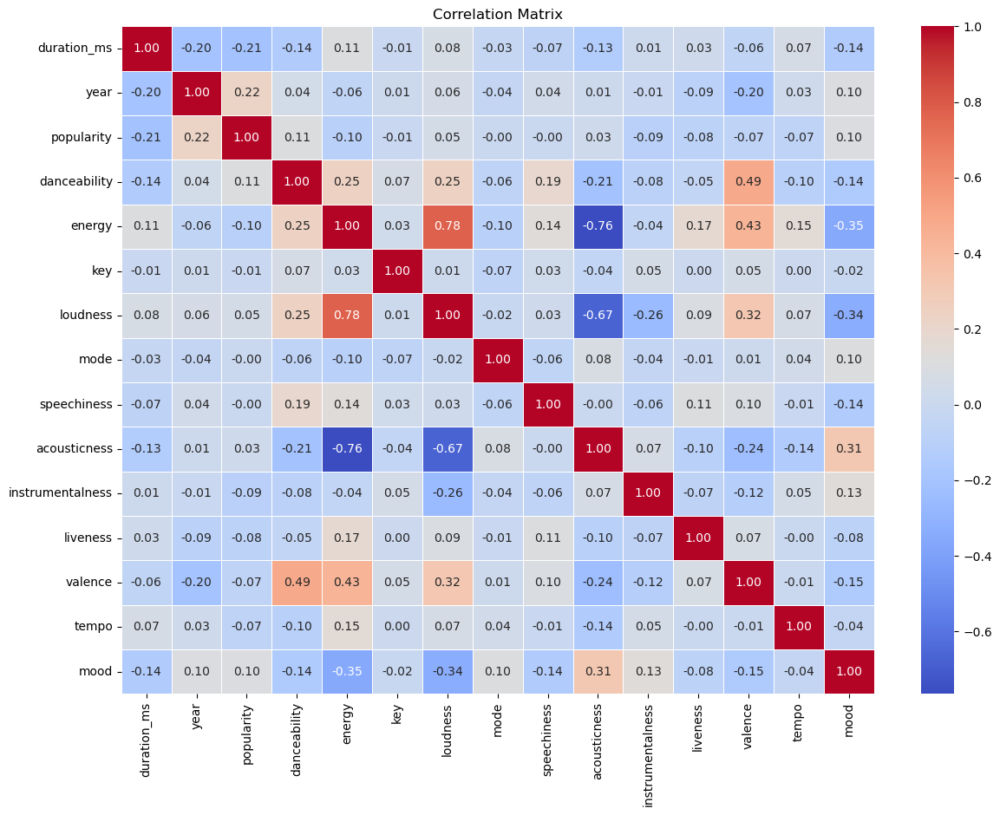

In [42]:
from sklearn.preprocessing import StandardScaler
# from sklearn.preprocessing import Sca

df_copy = df.dropna()
df_copy.drop(columns=["track_name","artist_name"], axis=1, inplace=True)

# Encode the mood as a numerical value
df_copy['mood'] = df_copy['mood'].astype('category').cat.codes

numeric_features = ['popularity', 'danceability', 'energy', 'key', 'loudness', 
                    'mode', 'speechiness', 'acousticness', 'instrumentalness', 
                    'liveness', 'valence', 'tempo', 'duration_ms']

non_numeric_columns = [col for col in df_copy.columns if col not in numeric_features and col not in ['mood', 'year', 'language']]
print("Non-numeric columns: ", non_numeric_columns)

numeric_data = df_copy[numeric_features]

# Scaling numeric features
scaler = StandardScaler()
df_copy[numeric_features] = scaler.fit_transform(numeric_data)

# Correlation matrix
correlation_matrix = df_copy.corr()

# Heatmap of the correlation matrix
plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

## Pairplot of numerical features colored by mood

/Users/zac/anaconda3/envs/model_music/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

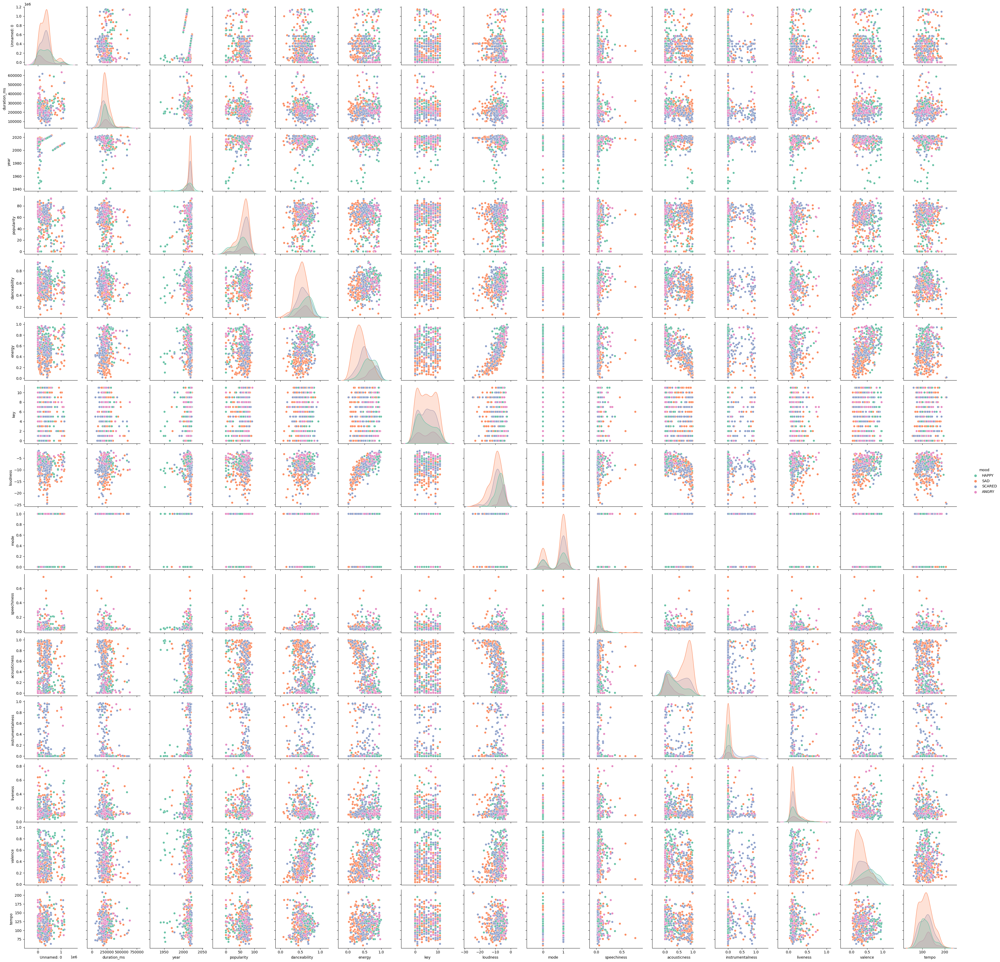

In [10]:

plt.figure(figsize=(15, 10))
sns.pairplot(df, hue='mood', palette='Set2')
plt.show()

## Boxplot for each feature by mood

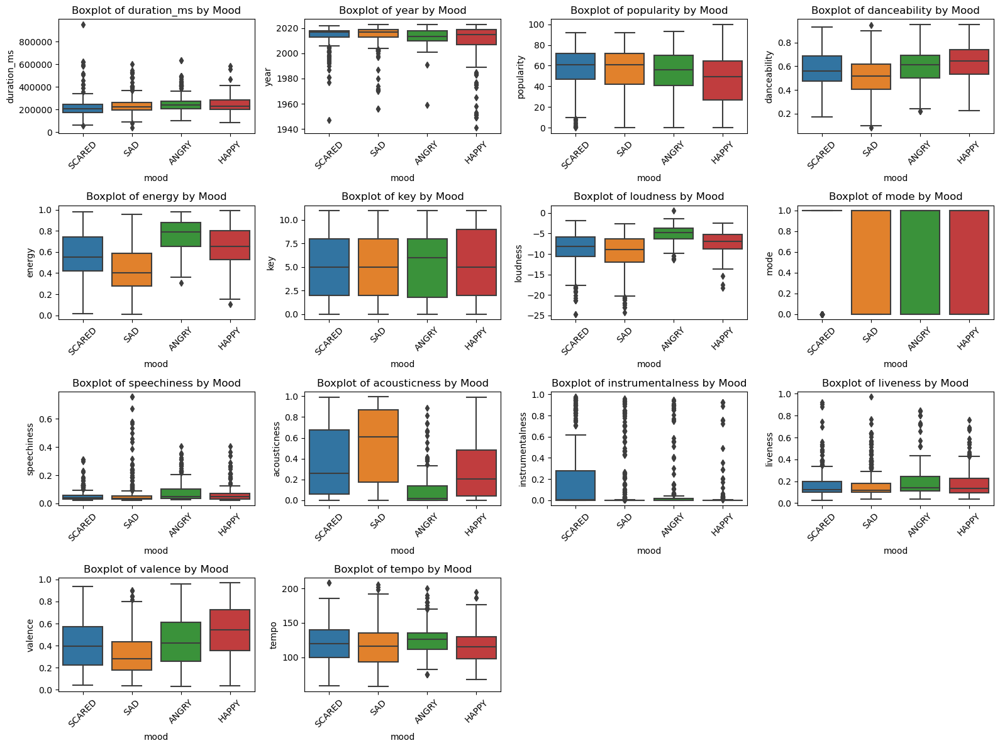

In [45]:

plt.figure(figsize=(16, 12))
for i, col in enumerate(df.select_dtypes(include=[np.number]).columns, 1):
    plt.subplot(4, 4, i)
    sns.boxplot(x='mood', y=col, data=df)
    plt.title(f'Boxplot of {col} by Mood')
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


## Distribution of track durations

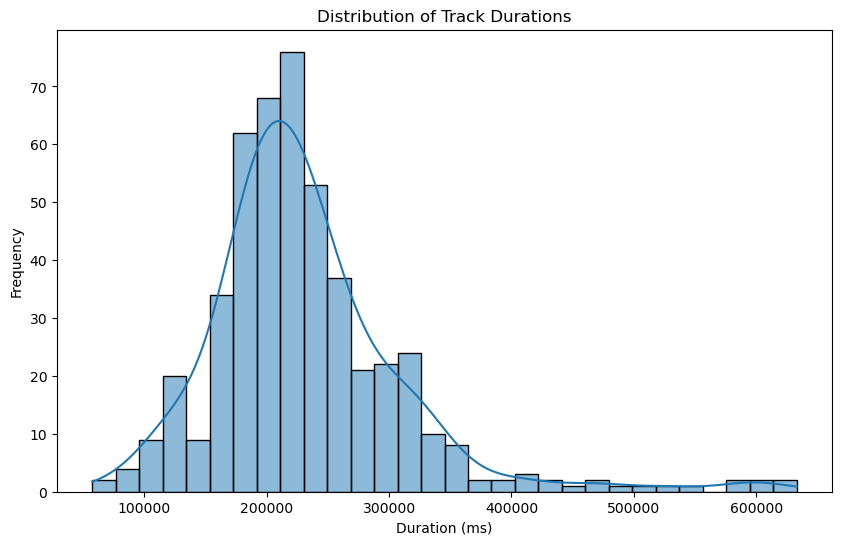

In [30]:
plt.figure(figsize=(10, 6))
sns.histplot(df['duration_ms'], bins=30, kde=True)
plt.title('Distribution of Track Durations')
plt.xlabel('Duration (ms)')
plt.ylabel('Frequency')
plt.show()

## Distribution of popularity

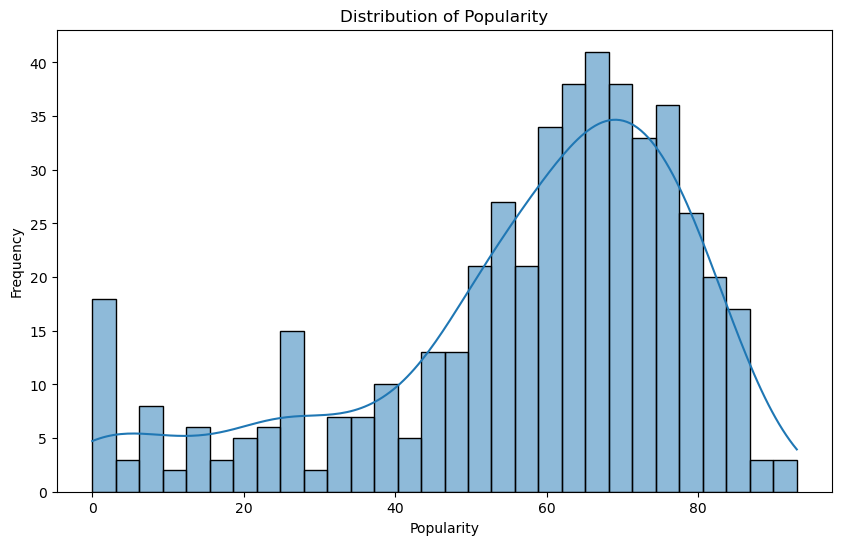

In [31]:

plt.figure(figsize=(10, 6))
sns.histplot(df['popularity'], bins=30, kde=True)
plt.title('Distribution of Popularity')
plt.xlabel('Popularity')
plt.ylabel('Frequency')
plt.show()

## Violin plots for a selected numerical feature by mood

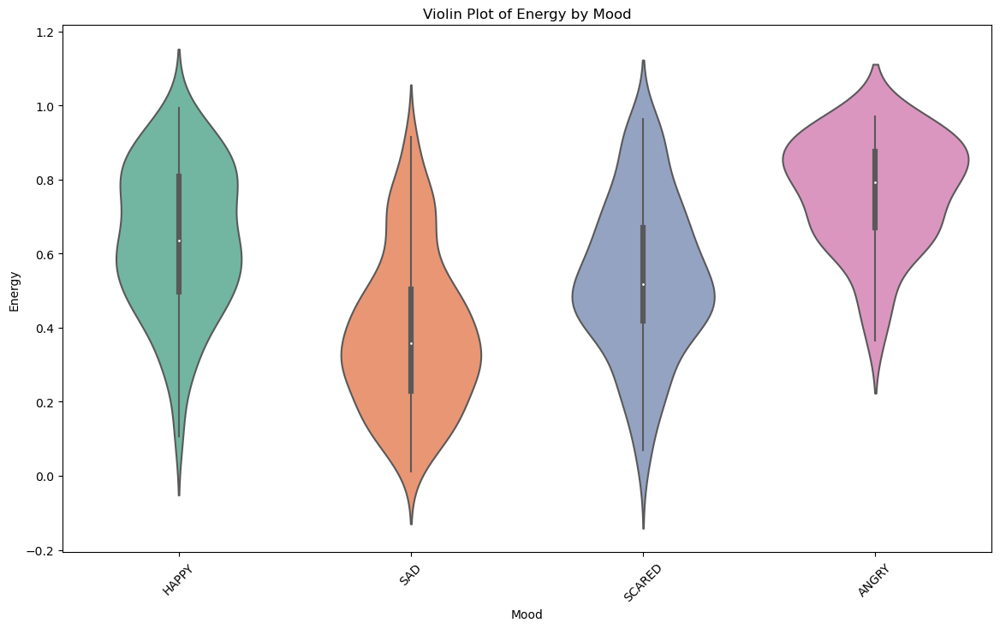

In [32]:
plt.figure(figsize=(14, 8))
sns.violinplot(x='mood', y='energy', data=df, palette='Set2')
plt.title('Violin Plot of Energy by Mood')
plt.xlabel('Mood')
plt.ylabel('Energy')
plt.xticks(rotation=45)
plt.show()

In [33]:
# Display unique moods
print("\nUnique moods in the dataset:")
print(df['mood'].unique())


Unique moods in the dataset:
['HAPPY' 'SAD' 'SCARED' 'ANGRY']


## Correlation between moods and other features

First few rows of the dataset:


,track_name,artist_name,mood,duration_ms,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo
0,Dil Dhadakne Do,Joi Barua & Suraj Jagan,HAPPY,230319,2011,59,0.778,0.599,2,-4.758,1,0.0320,0.0705,0.00000,0.5900,0.9490,116.951
1,Ek Ladki Bheegi Bhaagi si,Kishore Kumar,HAPPY,236800,1958,12,0.563,0.455,4,-7.010,0,0.0551,0.8080,0.00000,0.1540,0.8920,120.784
2,Ratchet Happy Birthday,Drake,HAPPY,207307,2018,52,0.657,0.571,2,-12.519,1,0.1390,0.1100,0.00123,0.0735,0.6220,167.958
3,Love On,Selena Gomez,HAPPY,229080,2015,69,0.672,0.593,11,-4.010,0,0.0304,0.0223,0.00000,0.2140,0.4380,98.020
4,I Know ?,Travis Scott,HAPPY,156886,2018,63,0.804,0.763,2,-5.480,1,0.0519,0.0678,0.00000,0.3680,0.0585,136.052



Mean values of numerical features for each mood:


,duration_ms,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo
mood,,,,,,,,,,,,,,
ANGRY,262056.720930,2012.674419,52.813953,0.606279,0.764279,5.116279,-5.228372,0.651163,0.087079,0.122184,0.096372,0.213893,0.467828,123.720605
HAPPY,246408.393617,2008.585106,46.851064,0.622489,0.639862,4.617021,-7.442181,0.638298,0.069567,0.319361,0.031186,0.184641,0.559930,115.907372
SAD,235479.283721,2015.883721,59.413953,0.513821,0.385933,5.102326,-10.075242,0.720930,0.063253,0.615098,0.070117,0.163045,0.300127,115.491135
SCARED,206295.015504,2015.558140,63.317829,0.573930,0.531515,5.015504,-9.049775,0.767442,0.051551,0.421663,0.238456,0.167749,0.413232,117.362101


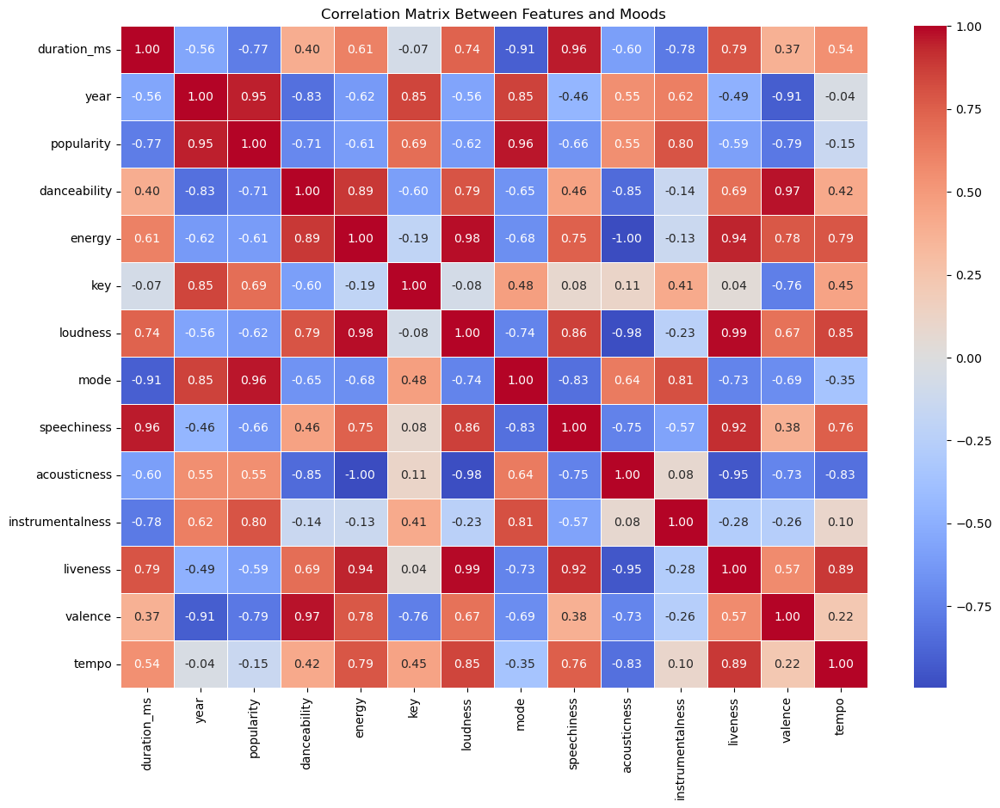

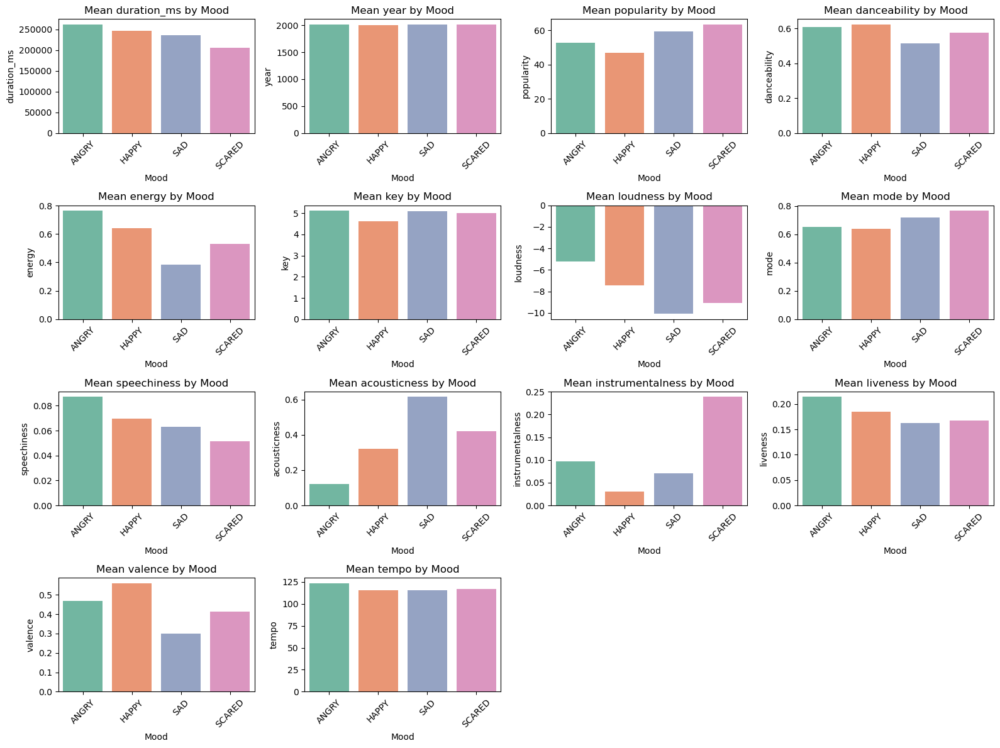

/Users/zac/anaconda3/envs/model_music/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


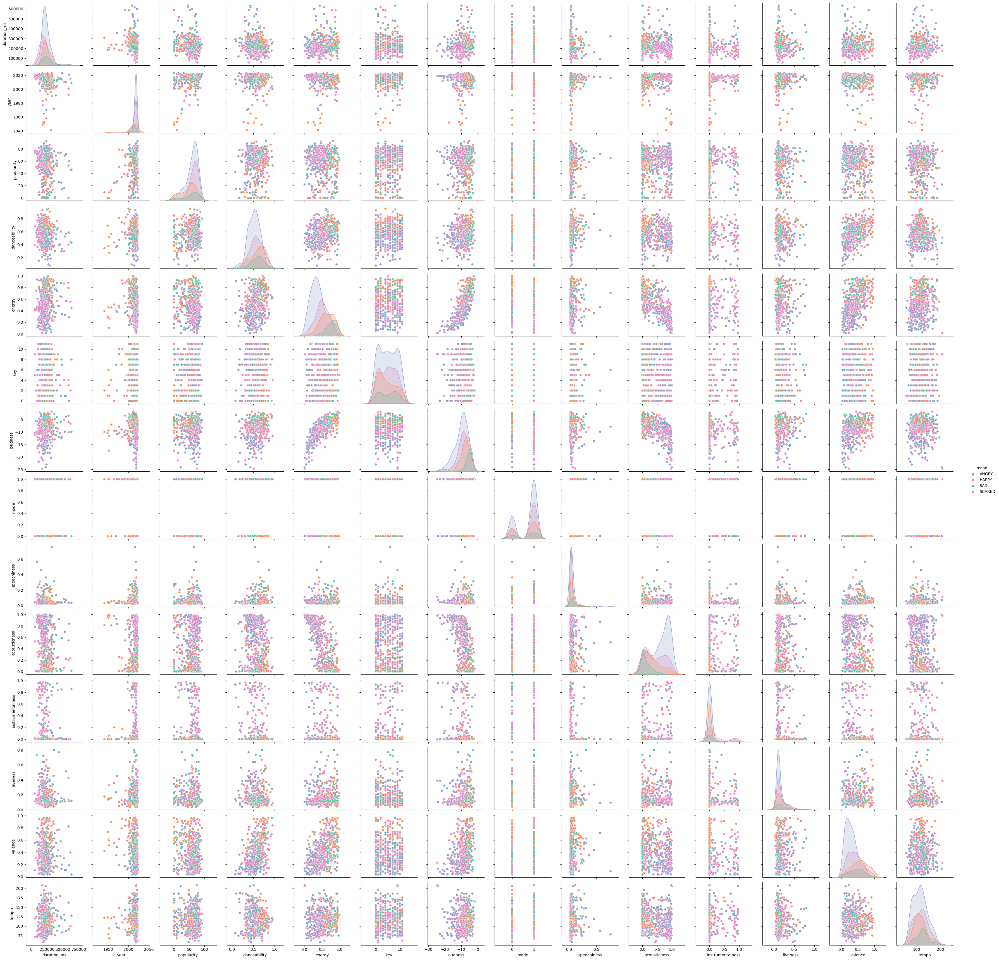

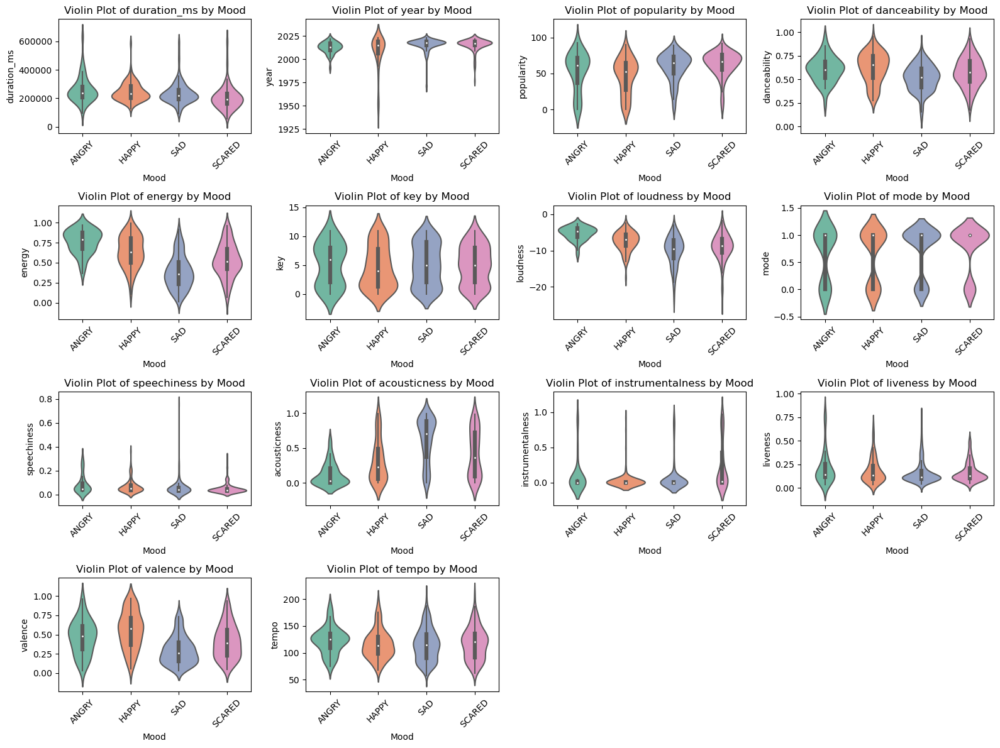

In [37]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np


# Display the first few rows of the dataset
print("First few rows of the dataset:")
display(df.head())


df_copy = df.dropna()
df_copy.drop(columns=["track_name","artist_name"], axis=1, inplace=True)

# Ensure 'mood' column is treated as a categorical variable
df_copy['mood'] = df_copy['mood'].astype('category')

# Calculate the mean values of numerical features for each mood
mood_means = df_copy.groupby('mood').mean()

# Display the first few rows of the calculated means
print("\nMean values of numerical features for each mood:")
display(mood_means.head())

# Correlation matrix between features and moods
# Since mood is categorical, we use the mean values for this
correlation_matrix = mood_means.corr()

# Heatmap of the correlation matrix
plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix Between Features and Moods')
plt.show()

# Bar plots for mean values of numerical features by mood
plt.figure(figsize=(16, 12))
for i, col in enumerate(df.select_dtypes(include=[np.number]).columns, 1):
    plt.subplot(4, 4, i)
    sns.barplot(x=mood_means.index, y=mood_means[col], palette='Set2')
    plt.title(f'Mean {col} by Mood')
    plt.xlabel('Mood')
    plt.ylabel(col)
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Pairplot of numerical features colored by mood
sns.pairplot(df, hue='mood', palette='Set2')
plt.show()

# Violin plots for each numerical feature by mood
plt.figure(figsize=(16, 12))
for i, col in enumerate(df.select_dtypes(include=[np.number]).columns, 1):
    plt.subplot(4, 4, i)
    sns.violinplot(x='mood', y=col, data=df, palette='Set2')
    plt.title(f'Violin Plot of {col} by Mood')
    plt.xlabel('Mood')
    plt.ylabel(col)
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


## After normalization

First few rows of the dataset:


,artist_name,track_name,duration_ms,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,mood
0,Mariah Carey,Loverboy,229173,2001,42,0.721,0.790,1,-4.125,1,0.1240,0.18300,0.0000,0.100,0.821,103.141,SCARED
1,Eminem,Without Me,290320,2002,87,0.908,0.669,7,-2.827,1,0.0738,0.00286,0.0000,0.237,0.662,112.238,SCARED
2,Coldplay,Clocks,307879,2002,79,0.577,0.749,5,-7.215,0,0.0279,0.59900,0.0115,0.183,0.255,130.970,SAD
3,Coldplay,Clocks,307879,2002,79,0.577,0.749,5,-7.215,0,0.0279,0.59900,0.0115,0.183,0.255,130.970,SAD
4,Linkin Park,Numb,185586,2003,81,0.496,0.863,9,-4.153,1,0.0381,0.00460,0.0000,0.639,0.243,110.018,SAD



Mean values of numerical features for each mood:


,duration_ms,year,popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo
mood,,,,,,,,,,,,,,
ANGRY,0.217316,-0.038601,-0.036323,0.250495,0.882272,0.012560,0.788555,-0.164548,0.284743,-0.831084,-0.002067,0.189440,0.166363,0.201786
HAPPY,0.127241,-0.429646,-0.358912,0.444432,0.408373,0.047164,0.232679,-0.130738,0.071703,-0.278233,-0.234345,0.098441,0.645799,-0.092584
SAD,-0.018530,0.130570,0.080018,-0.284137,-0.493348,-0.010563,-0.299544,0.048229,-0.062026,0.435102,-0.116336,-0.107474,-0.335360,-0.075577
SCARED,-0.216684,0.082902,0.130588,0.058358,0.039404,-0.022802,-0.151147,0.120758,-0.138125,-0.056085,0.407745,0.003632,0.074808,0.071258


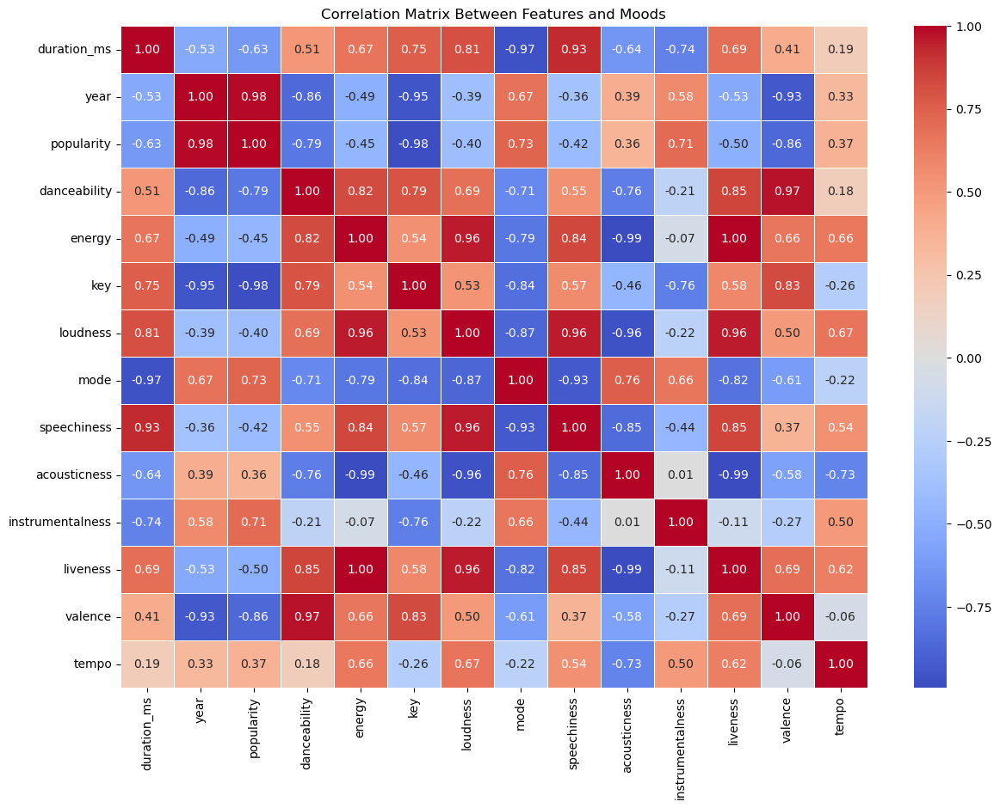

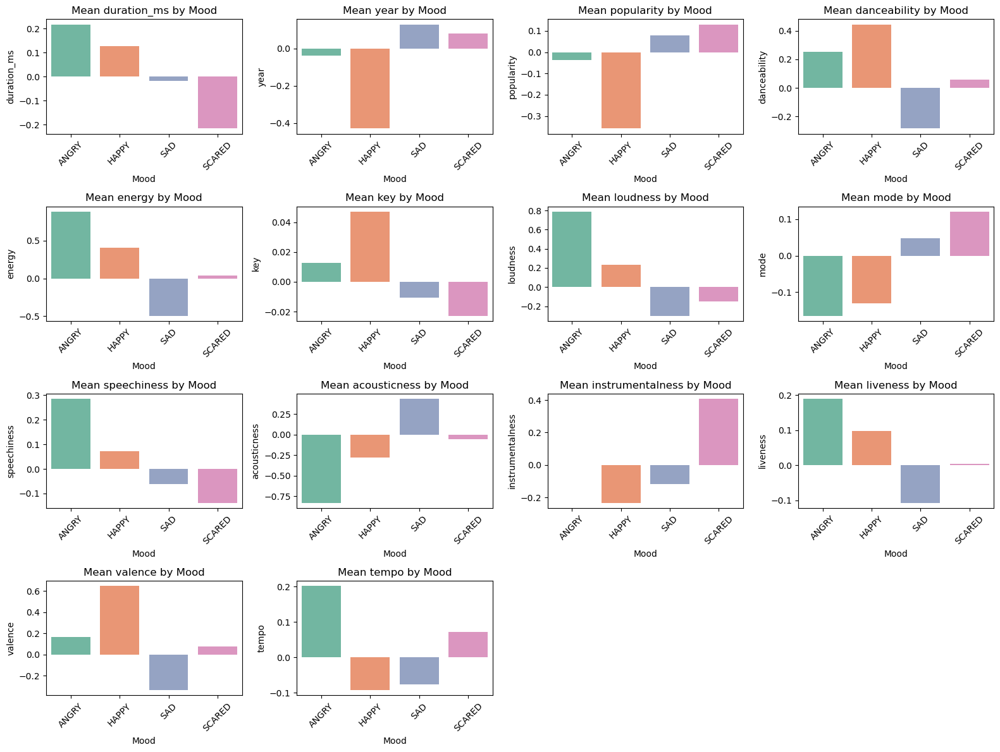

/Users/zac/anaconda3/envs/model_music/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


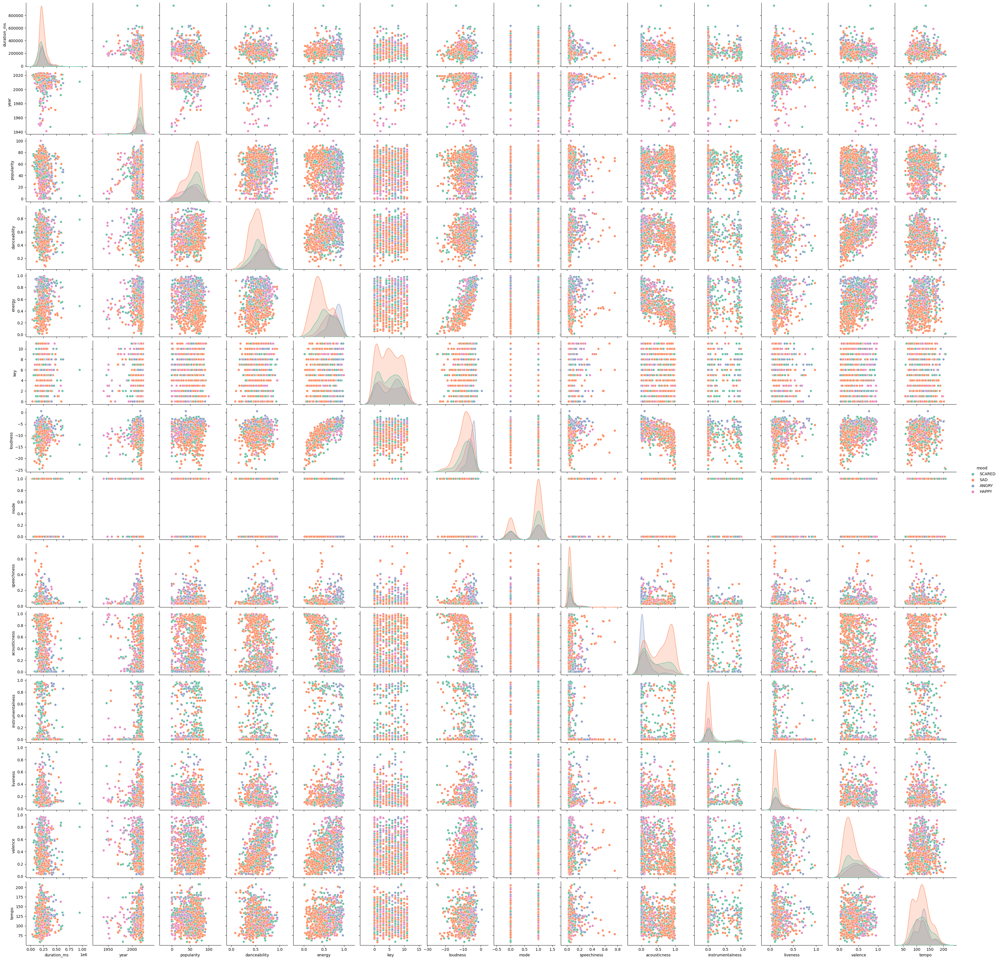

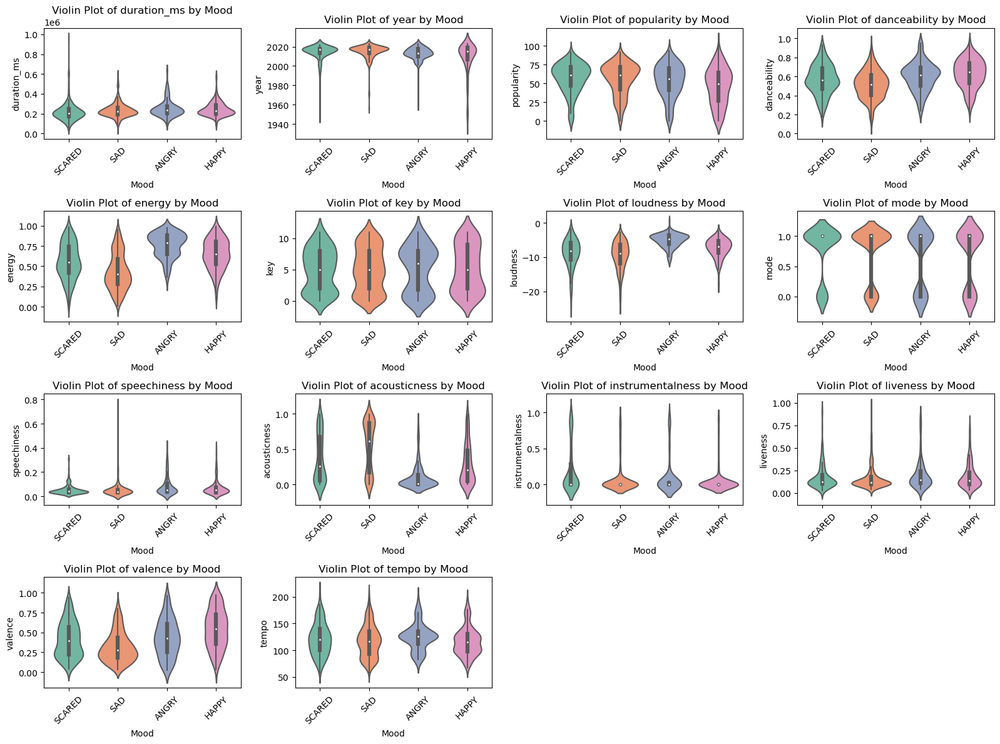

In [46]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import StandardScaler

# Display the first few rows of the dataset
print("First few rows of the dataset:")
display(df.head())

# Drop NaN values and unnecessary columns
df_copy = df.dropna()
df_copy.drop(columns=["track_name", "artist_name"], axis=1, inplace=True)

# Ensure 'mood' column is treated as a categorical variable
df_copy['mood'] = df_copy['mood'].astype('category')

# Scale and normalize numerical features
scaler = StandardScaler()
numerical_features = df_copy.select_dtypes(include=[np.number]).columns
df_copy[numerical_features] = scaler.fit_transform(df_copy[numerical_features])

# Calculate the mean values of numerical features for each mood
mood_means = df_copy.groupby('mood').mean()

# Display the first few rows of the calculated means
print("\nMean values of numerical features for each mood:")
display(mood_means.head())

# Correlation matrix between features and moods
# Since mood is categorical, we use the mean values for this
correlation_matrix = mood_means.corr()

# Heatmap of the correlation matrix
plt.figure(figsize=(14, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix Between Features and Moods')
plt.show()

# Bar plots for mean values of numerical features by mood
plt.figure(figsize=(16, 12))
for i, col in enumerate(df.select_dtypes(include=[np.number]).columns, 1):
    plt.subplot(4, 4, i)
    sns.barplot(x=mood_means.index, y=mood_means[col], palette='Set2')
    plt.title(f'Mean {col} by Mood')
    plt.xlabel('Mood')
    plt.ylabel(col)
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Pairplot of numerical features colored by mood
sns.pairplot(df, hue='mood', palette='Set2')
plt.show()

# Violin plots for each numerical feature by mood
plt.figure(figsize=(16, 12))
for i, col in enumerate(df.select_dtypes(include=[np.number]).columns, 1):
    plt.subplot(4, 4, i)
    sns.violinplot(x='mood', y=col, data=df, palette='Set2')
    plt.title(f'Violin Plot of {col} by Mood')
    plt.xlabel('Mood')
    plt.ylabel(col)
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
